In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
import IPython.display as ipd
import matplotlib.pyplot as plt
import numpy as np
import torch
import torchaudio
import torchaudio.transforms as T
from IPython.display import Audio as ipd_audio

In [4]:
classic_song = '/content/drive/MyDrive/SEM_4/SPEECH/Songs/Classical Music_Aaoge Jab Tum.mp3'
Hip_hop_song = '/content/drive/MyDrive/SEM_4/SPEECH/Songs/Hip-Hop_Azadi Lyrics.mp3'
pop_song = '/content/drive/MyDrive/SEM_4/SPEECH/Songs/Pop_Jo_Tum Mere Ho.mp3'
rock_song = '/content/drive/MyDrive/SEM_4/SPEECH/Songs/ROCK_Nadaan Parinde.mp3'

In [8]:
import torch
import torchaudio
import matplotlib.pyplot as plt
import torchaudio.transforms as T
from IPython.display import Audio as ipd_audio
import numpy as np

def plot_audio_features(file_path, song_type=None):
    waveform, sr = torchaudio.load(file_path)
    print(f"Sampling Rate: {sr}")
    display(ipd_audio(file_path))
    plt.figure(figsize=(12, 8))

    # Plot Waveform
    plt.subplot(2, 1, 1)
    plt.plot(waveform.t().numpy())
    plt.title(f"{song_type} Waveform")
    plt.xlabel("Time (samples)")
    plt.ylabel("Amplitude")
    plt.tight_layout()


    n_fft = 400
    transform = T.Spectrogram(n_fft=n_fft, hop_length=160, win_length=400, normalized=True)
    spec = transform(waveform)
    spec_db = torchaudio.transforms.AmplitudeToDB()(spec)
    freqs = torch.fft.fftfreq(n_fft, 1/sr)[:n_fft//2 + 1]

    plt.subplot(2, 1, 2)
    plt.imshow(spec_db[0].numpy(), cmap='inferno', origin='lower', aspect='auto', interpolation='none')
    plt.colorbar(format="%+2.0f dB")
    plt.title(f"{song_type} Spectrogram (STFT)")
    plt.xlabel("Time (frames)")
    plt.ylabel("Frequency (Hz)")

    num_ticks = 10
    tick_indices = np.linspace(0, len(freqs) - 1, num_ticks, dtype=int)
    tick_labels = np.round(freqs[tick_indices].numpy(), 2)

    plt.yticks(ticks=tick_indices, labels=tick_labels, color='black')

    plt.tight_layout()
    plt.show()

Sampling Rate: 48000


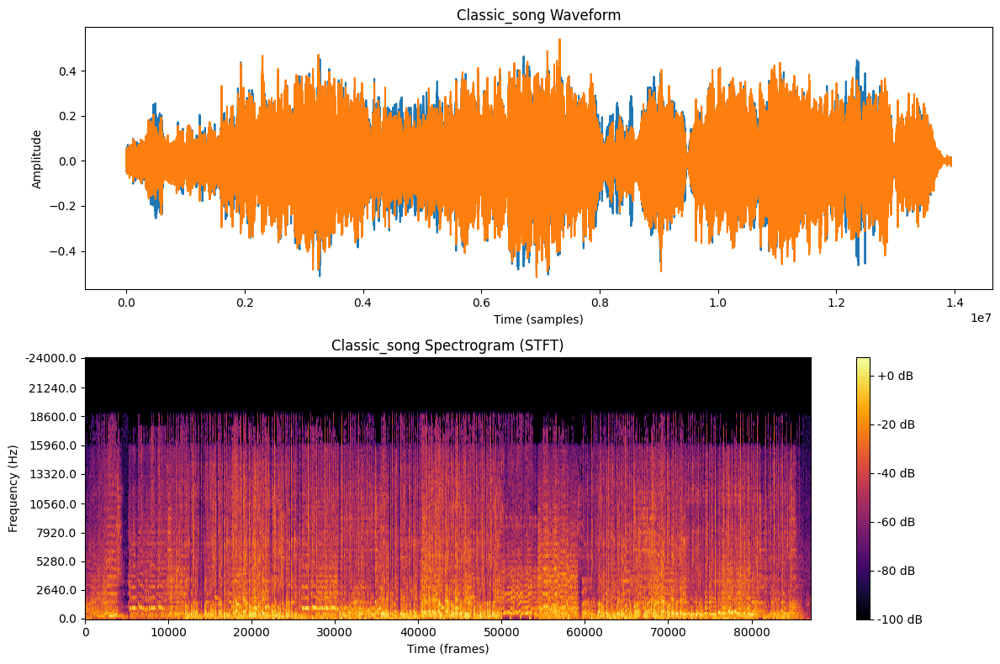

Sampling Rate: 48000


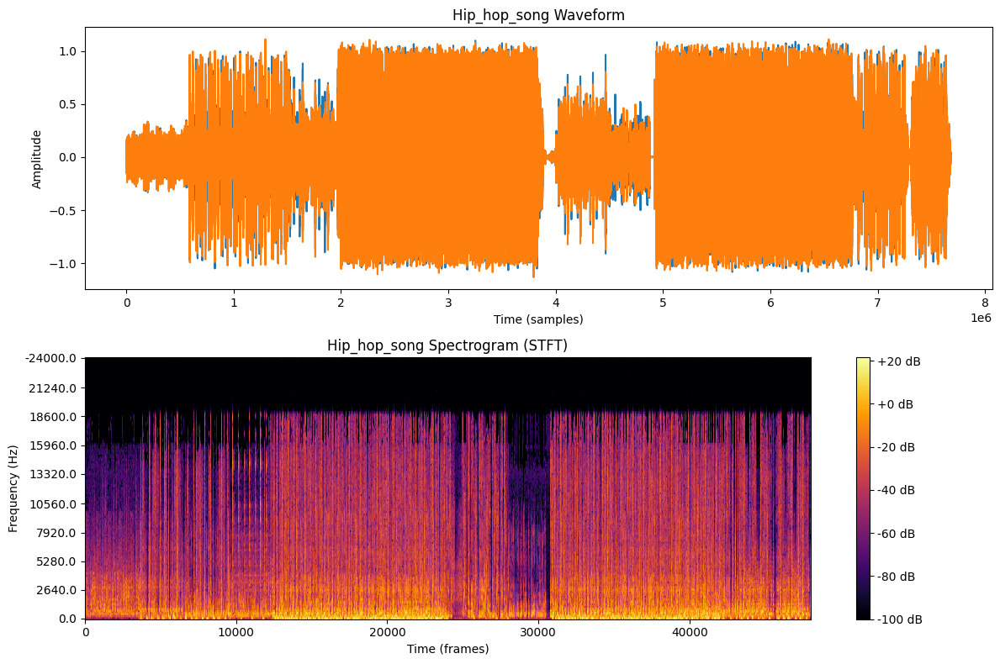

Sampling Rate: 48000


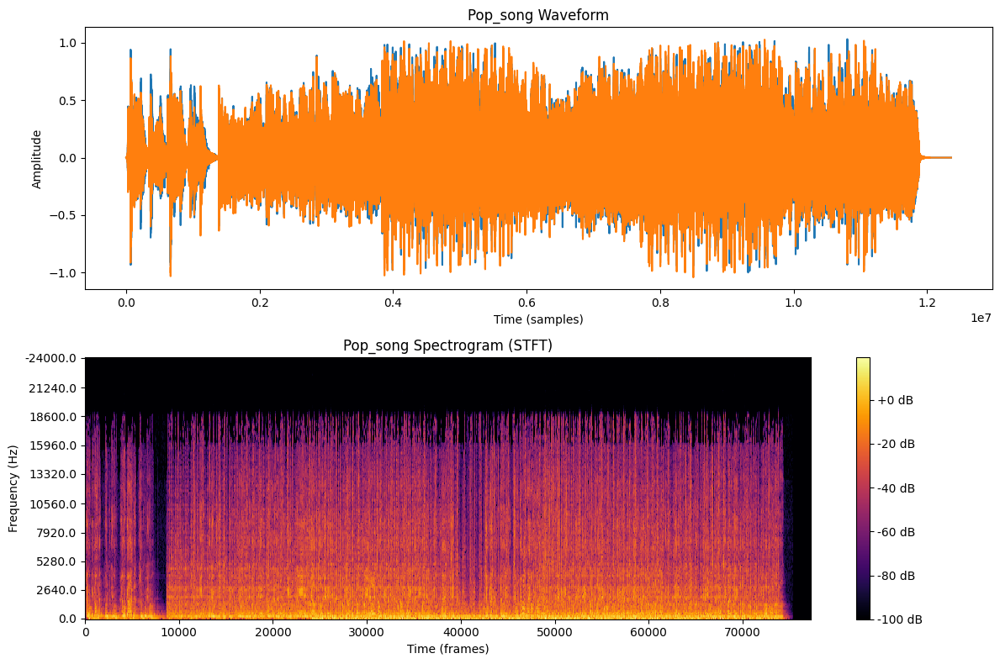

Sampling Rate: 48000


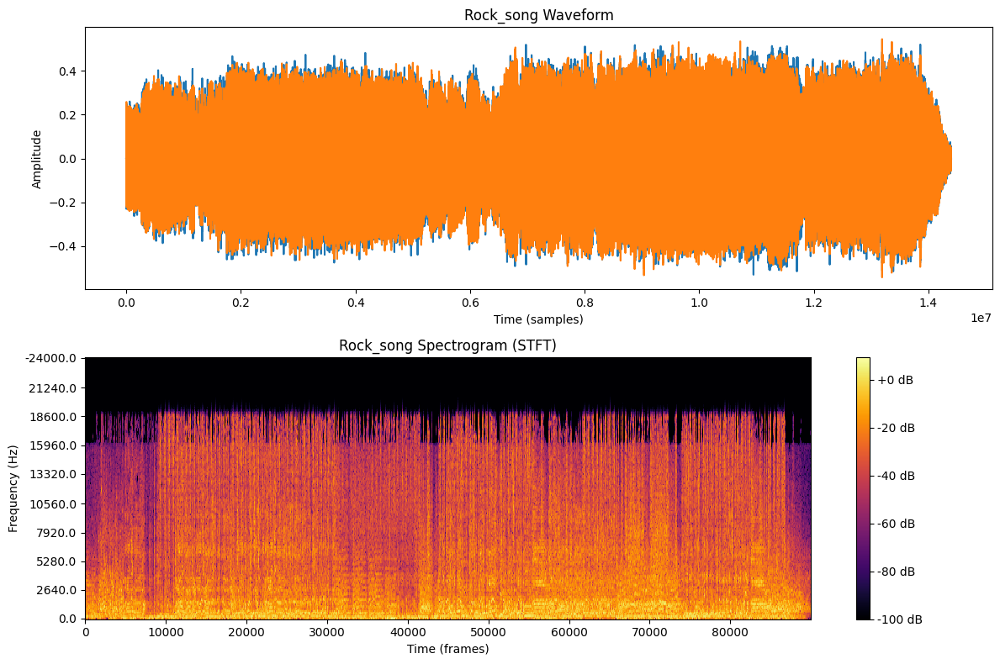

In [9]:
plot_audio_features(classic_song, song_type = 'Classic_song')
plot_audio_features(Hip_hop_song, song_type = 'Hip_hop_song')
plot_audio_features(pop_song, song_type = 'Pop_song')
plot_audio_features(rock_song, song_type = 'Rock_song')